# Image Analysis Project: Memory


In [1]:
%load_ext autoreload
%autoreload 2

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from typing import Any, List, Dict
import functions as f

# set up matplotlib for better display
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 12

In [ ]:
#********** Part 1. Data Preparation **********#

#IMG_DIR = "/Users/tuda/Desktop/CSN/Y1SP4-Image-Analysis/Project/data_jelly/"
IMG_DIR = "/Users/tuda/Desktop/CSN/Y1SP4-Image-Analysis/Project/data/"

# load images
img_paths = {
    'initial': os.path.join(IMG_DIR, 'initial.png'),
    'turns': [os.path.join(IMG_DIR, f'{i}.png') for i in range(1, 15)],
    'end': os.path.join(IMG_DIR, 'end.png')
}

# calculating the global scale
all_paths = [img_paths['initial']] + img_paths['turns'] + [img_paths['end']]
global_scale = f.calculate_global_scale(all_paths)

# load and show initial image
initial_img = f.load_and_preprocess_image(img_paths['initial'], global_scale=global_scale)
print(f"Initial image loaded and preprocessed: {initial_img.shape}")

Initial image loaded and preprocessed: (1632, 1224, 3)


In [3]:
#********** Part 2. Game Initialization **********#

# create a MemoryGame instance
game = f.MemoryGame()
print(f"Game state: {game.game_state}")

Game state: ready_to_start


Detected 16 cards
Back template created successfully


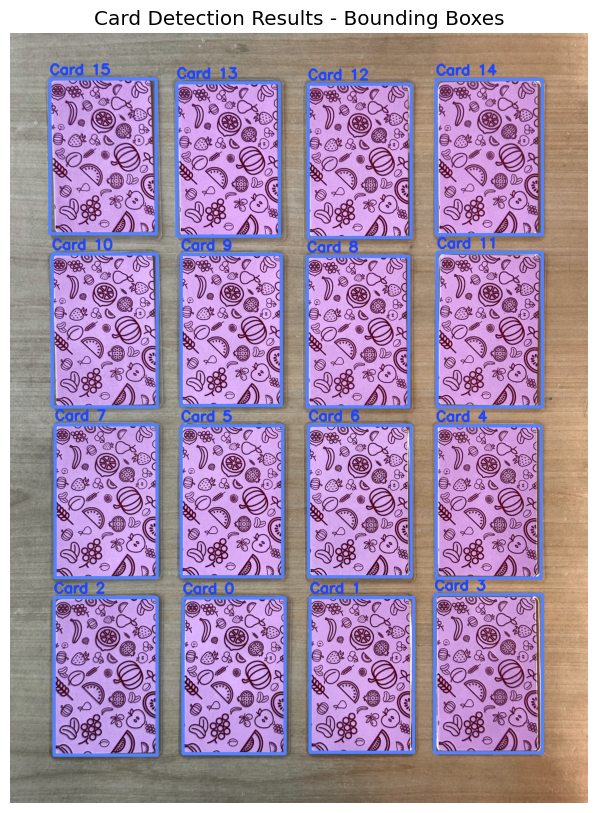

In [4]:

#********** Part 3. Card Detection Module **********#

# detect cards in initial image
detected_cards = f.detect_cards(initial_img)

game.back_template = f.create_back_template(initial_img, detected_cards)
if game.back_template is not None:
    print("Back template created successfully")
else:
    print("Failed to create back template")

# Visualize detection results
result_image = initial_img.copy()
for card in detected_cards:
    x, y, w, h = card['bbox']
    cv2.rectangle(result_image, (x, y), (x + w, y + h), (255, 130, 85), 5)
    cv2.putText(result_image, f"Card {card['id']}", (x, y - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 70, 30), 3)

plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.title("Card Detection Results - Bounding Boxes", loc='center')
plt.axis('off')
plt.show()

In [5]:
#********** Part 4. Face Up/Down Detection Module **********#
# detect face up/down cards and update game state
def face_up_down_detection(img, detected_cards, game):
    face_up_num = 0
    face_down_num = 0
    game.turned_cards = []

    for i, card in enumerate(detected_cards):
        bbox = card['bbox']
        card_region = f.extract_card_region(img, bbox)
        card_state = f.classify_card_state(card_region, game.back_template)
        #print(f"Card {i}: {card_state}")

        # update game state
        game.cards[i] = {
            'bbox': bbox,
            'state': card_state,
            'region': card_region
        }
        
        if card_state == 'face_up':
            face_up_num += 1
            game.turned_cards.append(i)
        else:
            face_down_num += 1
    
    return face_up_num, face_down_num

face_up_num, face_down_num = face_up_down_detection(initial_img, detected_cards, game)
print(f"\nClassification results:")
print(f"Face up cards num: {face_up_num}")
print(f"Face down cards num: {face_down_num}")
if face_up_num > 0:
    print(f"Face up cards id: {game.turned_cards}")


Classification results:
Face up cards num: 0
Face down cards num: 16


Detected 16 cards

Classification results:
Face up cards num: 2
Face down cards num: 14
Face up cards id: [1, 12]
Turn 1:Cards 1 and 12 match: False


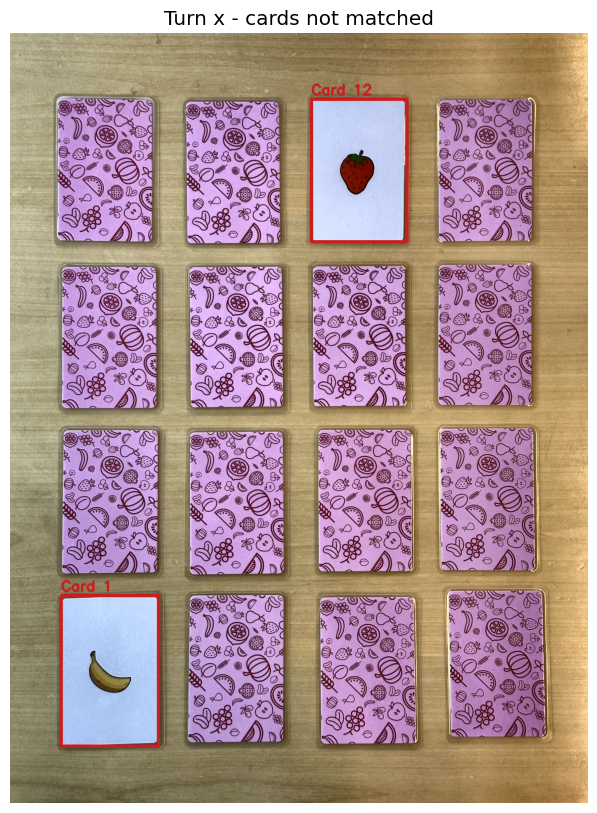

In [6]:
#********** Part 5. Card Matching Module **********#

# load one of the turn images
turn_path = img_paths['turns'][0]
turn_img = f.load_and_preprocess_image(turn_path, global_scale=global_scale)

turn_detected_cards = f.detect_cards(turn_img)

face_up_num_turn, face_down_num_turn = face_up_down_detection(turn_img, turn_detected_cards, game)

print(f"\nClassification results:")
print(f"Face up cards num: {face_up_num_turn}")
print(f"Face down cards num: {face_down_num_turn}")    

turned_cards = game.get_turned_cards()
if face_up_num_turn == 2:
    print(f"Face up cards id: {game.turned_cards}")
    id1, id2 = game.turned_cards[0], game.turned_cards[1]
    card1_region = f.extract_card_region(turn_img, turn_detected_cards[id1]['bbox'])
    card2_region = f.extract_card_region(turn_img, turn_detected_cards[id2]['bbox'])

    match = f.match_cards(card1_region, card2_region)
    print(f"Turn 1:Cards {id1} and {id2} match: {match}")
    turn_result_image = f.result_visualization(turn_img, turn_detected_cards, (id1, id2), match)

    plt.imshow(cv2.cvtColor(turn_result_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Turn x - cards {'matched' if match else 'not matched'}")
    plt.axis('off')
    plt.show()
else:
    print("No face up cards or more than 2 face up cards are detected")
    turn_result_image = f.result_visualization(turn_img, turn_detected_cards)

    plt.imshow(cv2.cvtColor(turn_result_image, cv2.COLOR_BGR2RGB))
    plt.title(f"{face_up_num_turn} face up cards detected")
    plt.axis('off')
    plt.show()

🎮 Game start!
Detected 16 cards


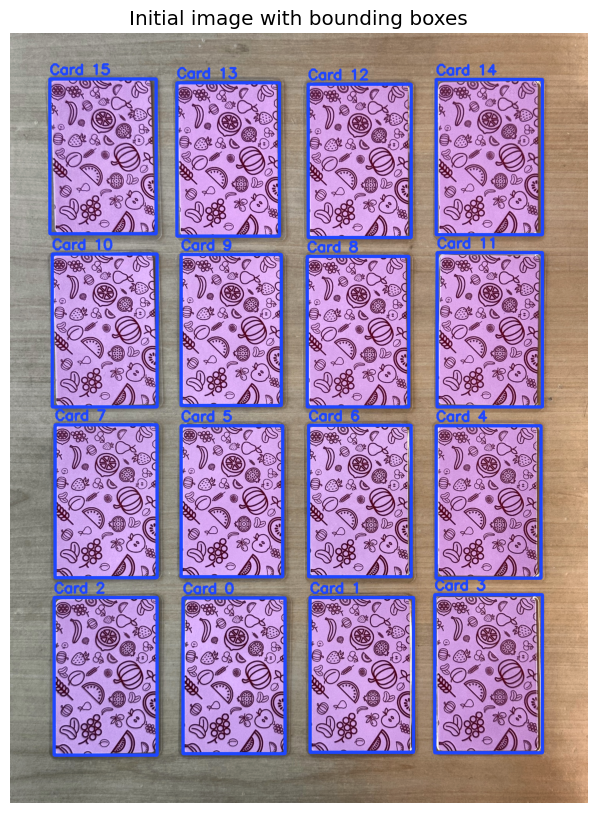

💬 Game instruction: Player 1, please choose two cards to turn.
Current scores: Player 1: 0, Player 2: 0


In [9]:
#********** Part 6. Game Flow - initial state **********#
game.reset_game()
#****** 1. game start ******#
print("🎮 Game start!")
detected_cards = f.detect_cards(initial_img)
#****** 2. create back template ******#
game.back_template = f.create_back_template(initial_img, detected_cards)
#****** 3. initialize game ******#
face_up_num, face_down_num = face_up_down_detection(initial_img, detected_cards, game)
message, match_pair, match_result = f.update_game_state(game, initial_img, detected_cards)

#****** 4. show initial image with bounding boxes ******#
result_image = f.result_visualization(initial_img, detected_cards)

plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.title("Initial image with bounding boxes")
plt.axis('off')
plt.show()

print("💬 Game instruction:", message)
print(f"Current scores: Player 1: {game.player_scores[1]}, Player 2: {game.player_scores[2]}")


****** Turn 1 ******
Detected 16 cards
Face up card ids: [1, 12]


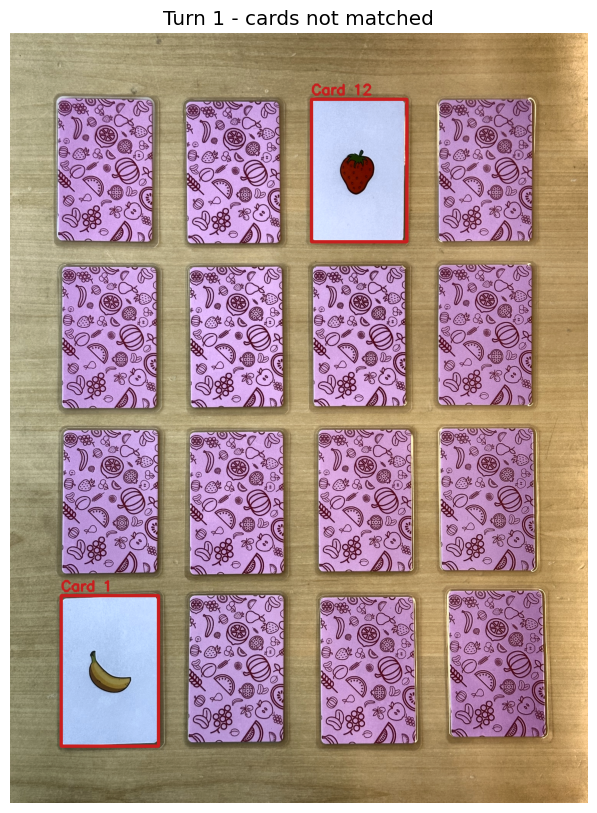

💬 Game instruction: No match! Turn back the two cards face down again. Player 2 may then continue.
Current scores: Player 1: 0, Player 2: 0

****** Turn 2 ******
Detected 16 cards
Face up card ids: [7, 10]


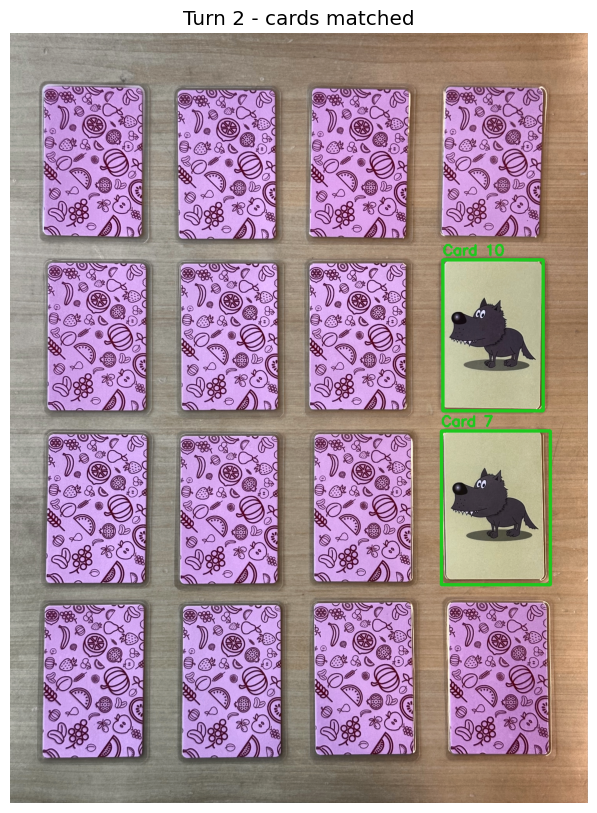

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 0, Player 2: 1

****** Turn 3 ******
Detected 14 cards
Face up card ids: [0, 12]


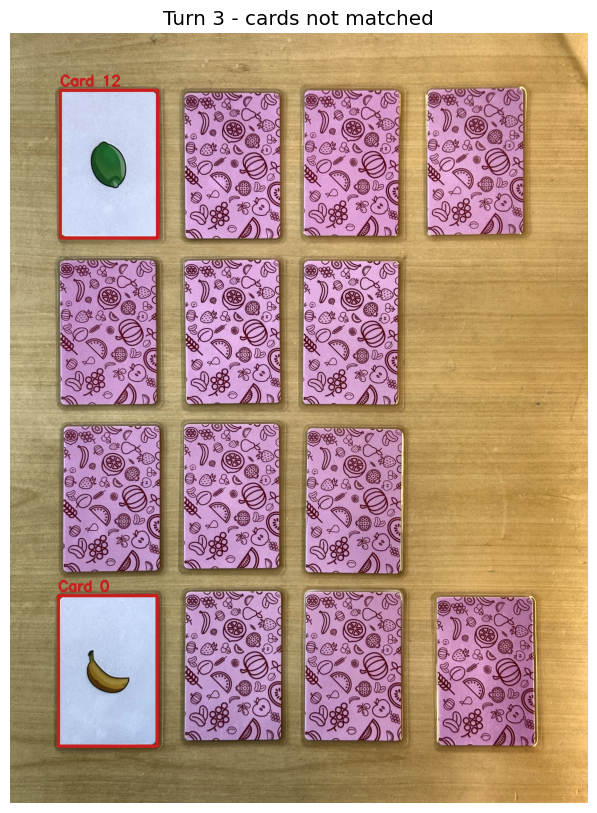

💬 Game instruction: No match! Turn back the two cards face down again. Player 1 may then continue.
Current scores: Player 1: 0, Player 2: 1

****** Turn 4 ******
Detected 14 cards
Face up card ids: [1, 5]


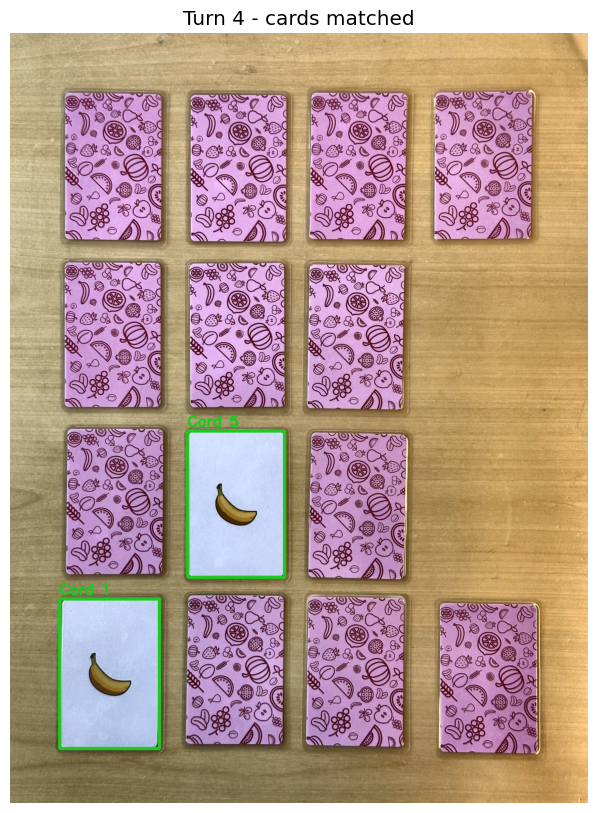

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 1, Player 2: 1

****** Turn 5 ******
Detected 12 cards
Face up card ids: [2, 5]


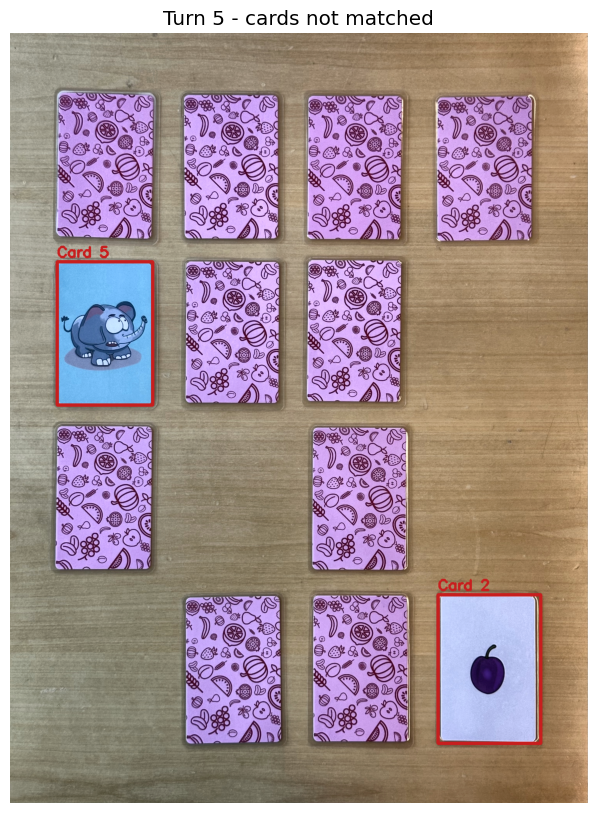

💬 Game instruction: No match! Turn back the two cards face down again. Player 2 may then continue.
Current scores: Player 1: 1, Player 2: 1

****** Turn 6 ******
Detected 12 cards
Face up card ids: [1, 10]


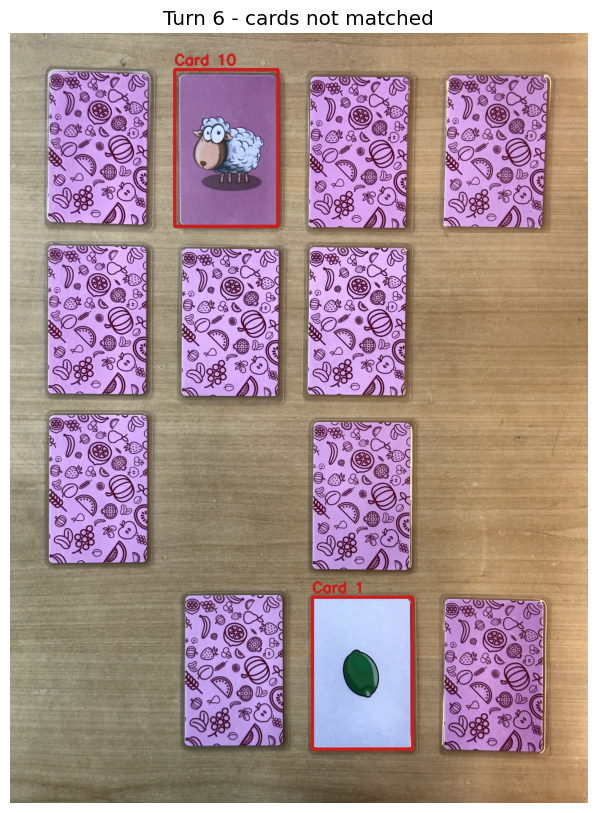

💬 Game instruction: No match! Turn back the two cards face down again. Player 1 may then continue.
Current scores: Player 1: 1, Player 2: 1

****** Turn 7 ******
Detected 12 cards
Face up card ids: [4, 10]


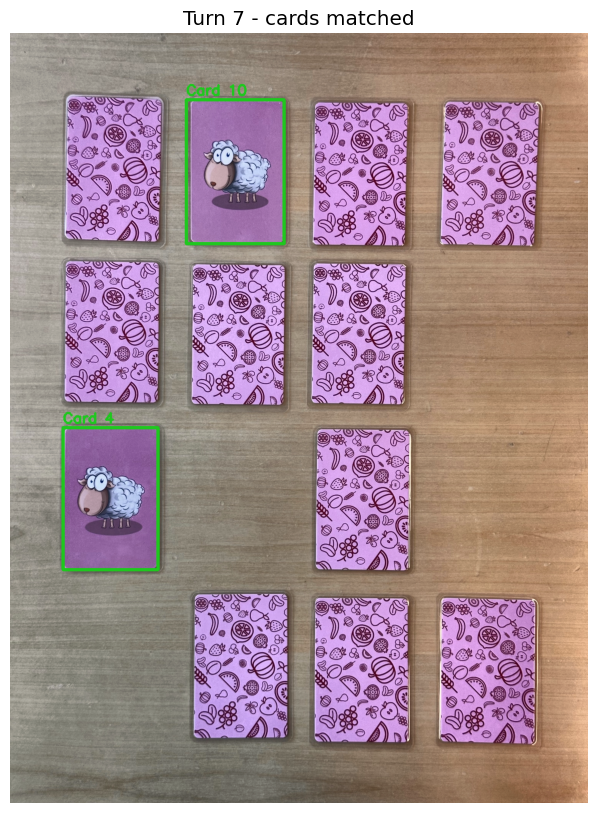

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 2, Player 2: 1

****** Turn 8 ******
Detected 10 cards
Face up card ids: [3, 6]


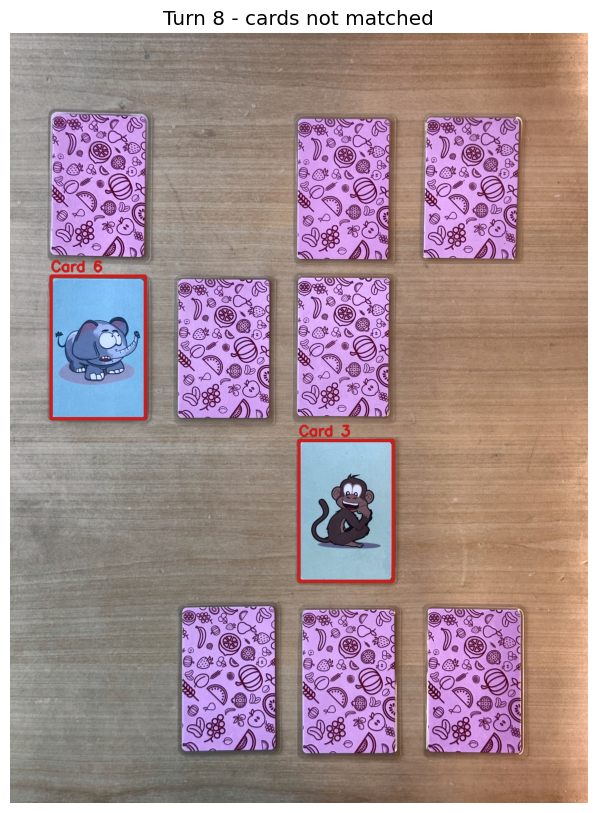

💬 Game instruction: No match! Turn back the two cards face down again. Player 2 may then continue.
Current scores: Player 1: 2, Player 2: 1

****** Turn 9 ******
Detected 10 cards
Face up card ids: [1, 6]


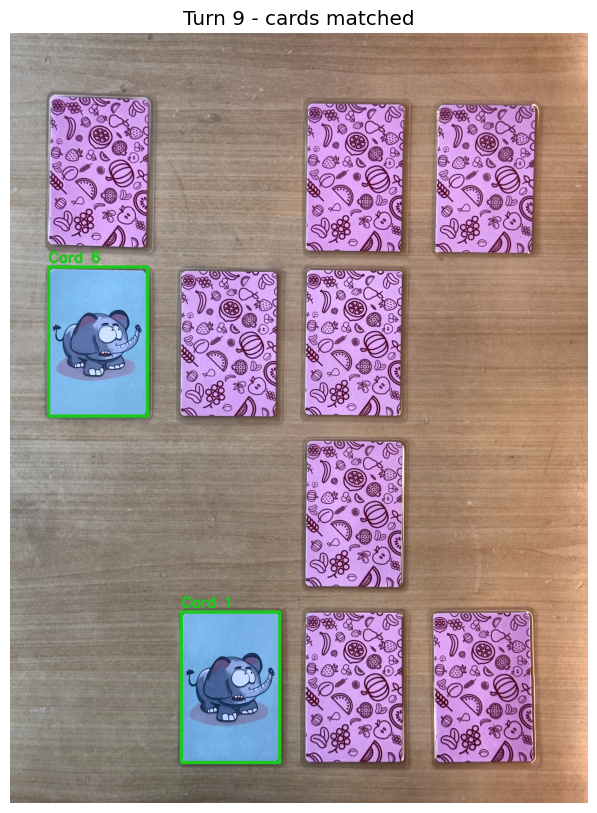

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 2, Player 2: 2

****** Turn 10 ******
Detected 8 cards
Face up card ids: [0, 3]


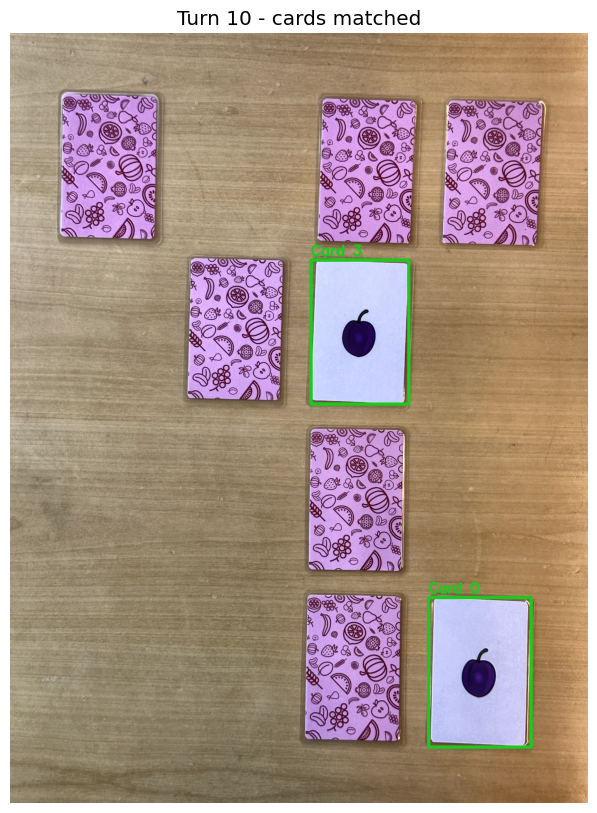

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 2, Player 2: 3

****** Turn 11 ******
Detected 6 cards
Face up card ids: [2, 3]


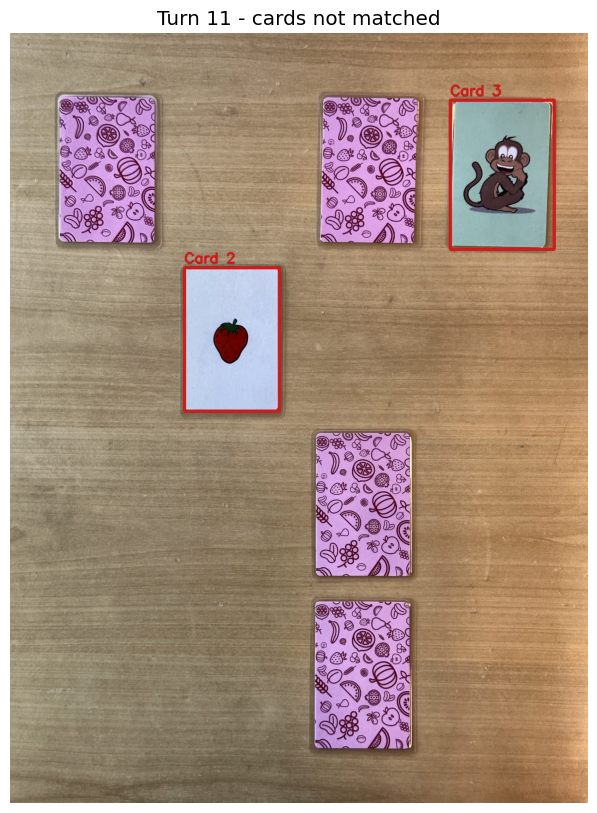

💬 Game instruction: No match! Turn back the two cards face down again. Player 1 may then continue.
Current scores: Player 1: 2, Player 2: 3

****** Turn 12 ******
Detected 6 cards
Face up card ids: [1, 3]


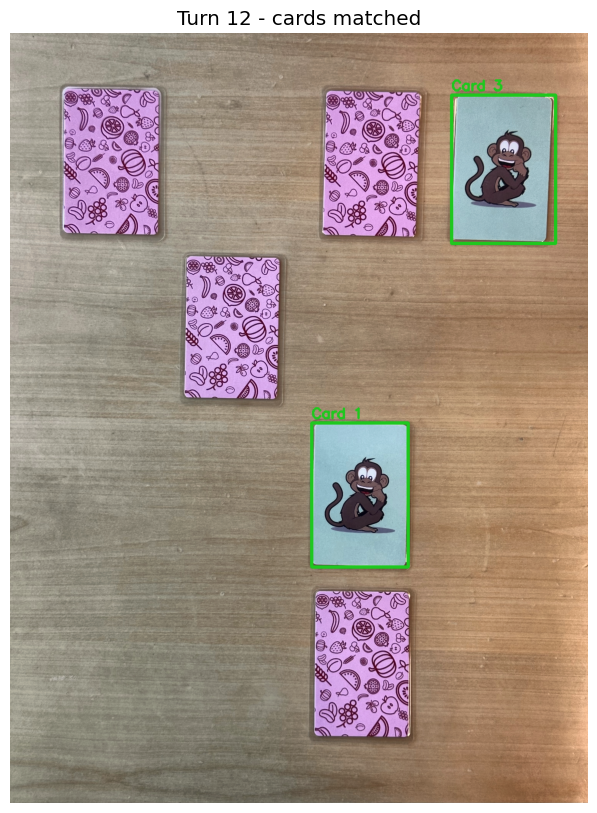

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 3, Player 2: 3

****** Turn 13 ******
Detected 4 cards
Face up card ids: [1, 2]


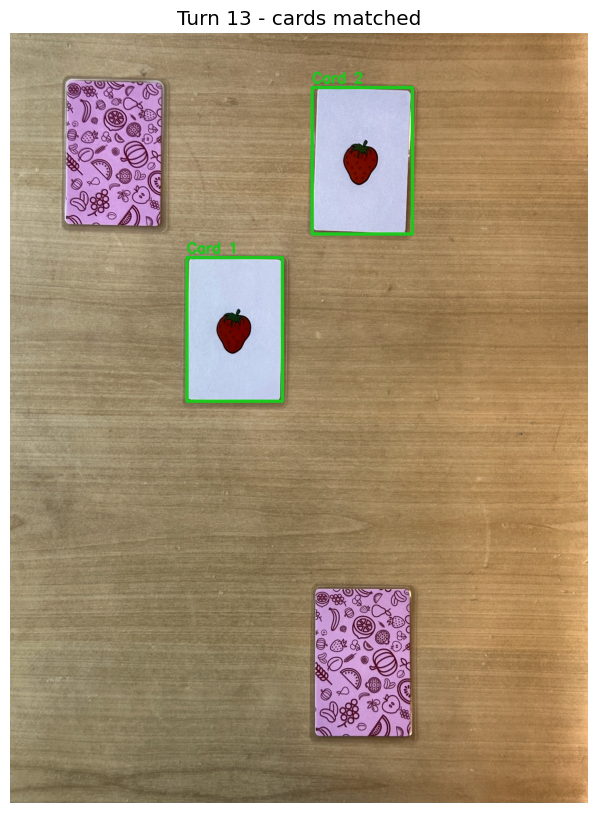

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 4, Player 2: 3

****** Turn 14 ******
Detected 2 cards
Face up card ids: [0, 1]


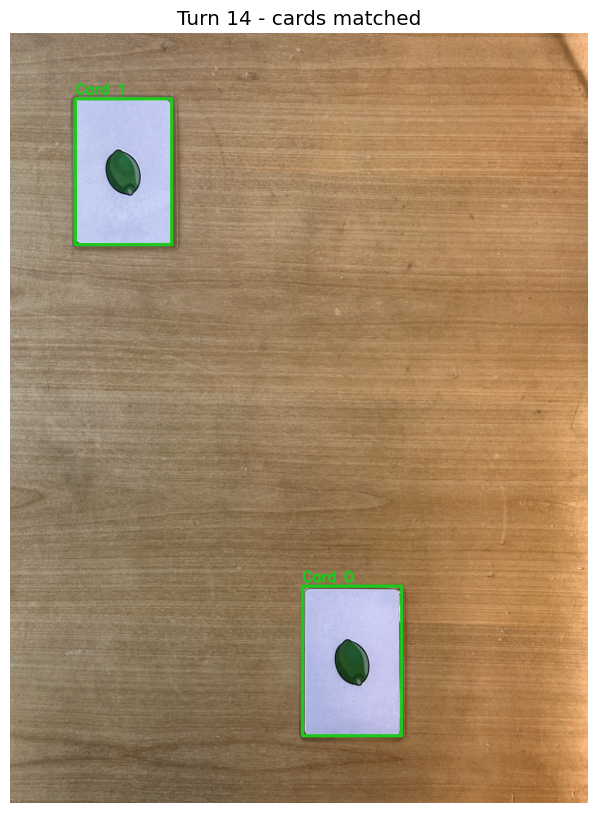

💬 Game instruction: Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Current scores: Player 1: 5, Player 2: 3
Detected 0 cards
🎮 Game over!


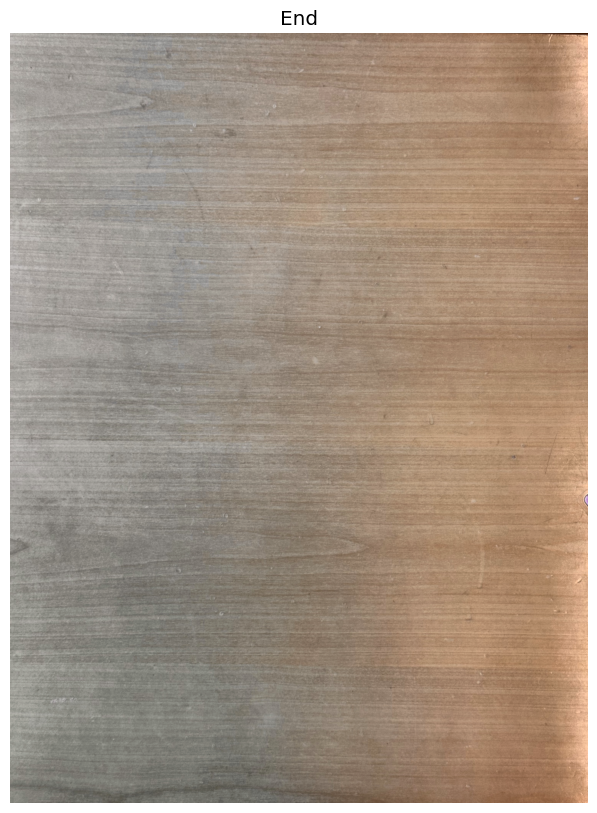

🏅 Final results:

Player 1 score: 5 pairs 
Player 2 score: 3 pairs 
Winner is Player 1.


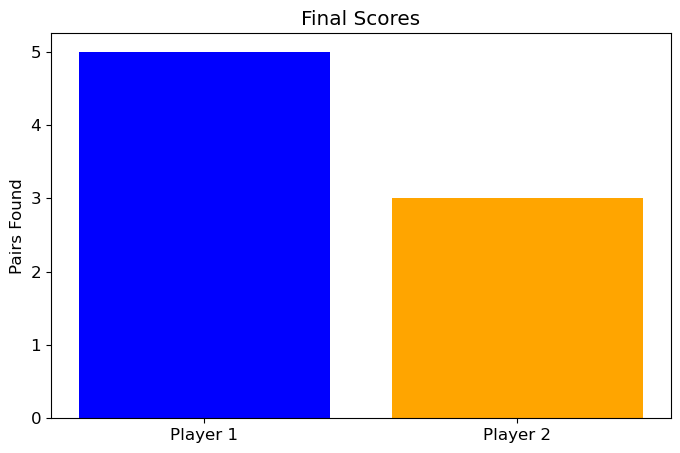

In [10]:
#********** Part 7. Game Flow - turns **********#
for turn_num, turn_path in enumerate(img_paths['turns'], 1): #number turns from 1
    print(f"\n****** Turn {turn_num} ******")

    # load and preprocess turn image
    turn_img = f.load_and_preprocess_image(turn_path, global_scale=global_scale)
    turn_detected_cards = f.detect_cards(turn_img)

    # update game state
    face_up_num_turn, face_down_num_turn = face_up_down_detection(turn_img, turn_detected_cards, game)
    message, match_pair, match_result = f.update_game_state(game, turn_img, turn_detected_cards)

    # visualize turn image
    result_image = f.result_visualization(turn_img, turn_detected_cards, match_pair, match_result)

    plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Turn {turn_num} - cards {'matched' if match_result else 'not matched'}")
    plt.axis('off')
    plt.show()

    print("💬 Game instruction:", message)
    print(f"Current scores: Player 1: {game.player_scores[1]}, Player 2: {game.player_scores[2]}")

#********** Part 8. Game Flow - the end **********#
end_path = img_paths['end']
end_img = f.load_and_preprocess_image(end_path, global_scale=global_scale)
end_detected_cards = f.detect_cards(end_img)

face_up_num_end, face_down_num_end = face_up_down_detection(end_img, end_detected_cards, game)
message = f.update_game_state(game, end_img, end_detected_cards)
print("🎮 Game over!")

result_image = f.result_visualization(end_img, end_detected_cards)

plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.title(f"End")
plt.axis('off')
plt.show()

print("🏅 Final results:")
print(message)

# score visualization
plt.figure(figsize=(8, 5))
plt.bar(['Player 1', 'Player 2'], 
        [game.player_scores[1], game.player_scores[2]],
        color=['blue', 'orange'])
plt.title('Final Scores')
plt.ylabel('Pairs Found')
plt.show()

In [11]:
def evaluate_turn(
    turn_name: str,
    img_path: str,
    ground_truth_count: int,
    ground_truth_faceup: List[int],
    ground_truth_match: Dict[str, Any],
    game: f.MemoryGame
) -> Dict[str, Any]:
    """
    Evaluate detection, classification, and matching on a single turn.
    """
    img = f.load_and_preprocess_image(img_path, global_scale=global_scale)
    detected_cards = f.detect_cards(img)

    # Detection accuracy
    det_acc = f.detection_count_accuracy(detected_cards, ground_truth_count)

    # Classification ground truth
    gt_state = {
        i: "face_up" if i in ground_truth_faceup else "face_down"
        for i in range(len(detected_cards))
    }

    # Update game and evaluate classification
    _, _ = face_up_down_detection(img, detected_cards, game)
    _, match_pair, match_result = f.update_game_state(game, img, detected_cards)
    cls_acc = f.classification_accuracy(game, gt_state)

    # Matching accuracy
    match_attempt = {
        "card1": ground_truth_match["card1"],
        "card2": ground_truth_match["card2"],
        "prediction": match_result,
        "ground_truth": ground_truth_match["ground_truth"]
    }
    match_acc = f.match_accuracy([match_attempt])

    # Visualization
    vis_img = f.result_visualization(img, detected_cards, match_pair, match_result)

    # Return evaluation summary
    return {
        "turn": turn_name,
        "det_acc": det_acc,
        "cls_acc": cls_acc,
        "match_acc": match_acc,
        "match_result": match_result,
        "image": vis_img
    }


Detected 12 cards
Face up card ids: [4, 10]

=== Evaluation of turn7 ===
Detection Accuracy: 100.00%
Classification Accuracy: 100.00%
Matching Accuracy: 100.00%


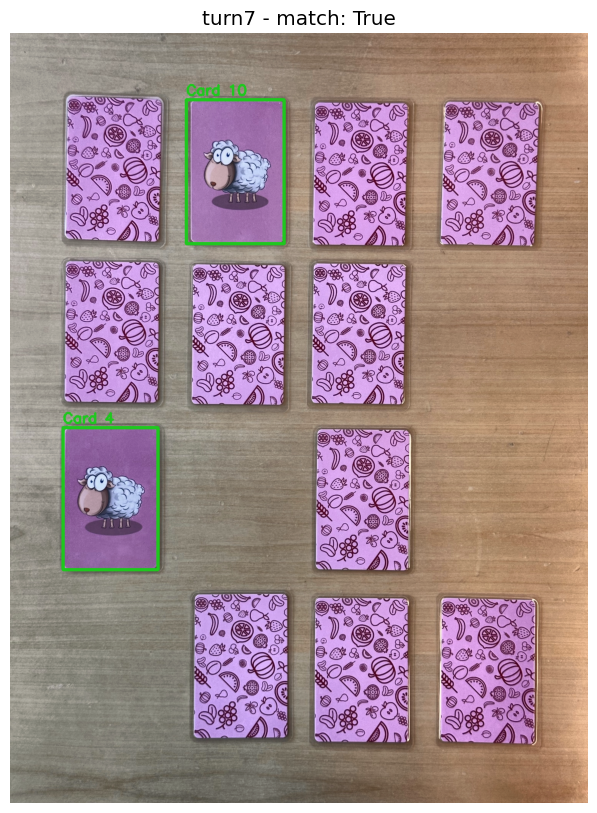

Detected 6 cards
Face up card ids: [2, 3]

=== Evaluation of turn11 ===
Detection Accuracy: 100.00%
Classification Accuracy: 100.00%
Matching Accuracy: 100.00%


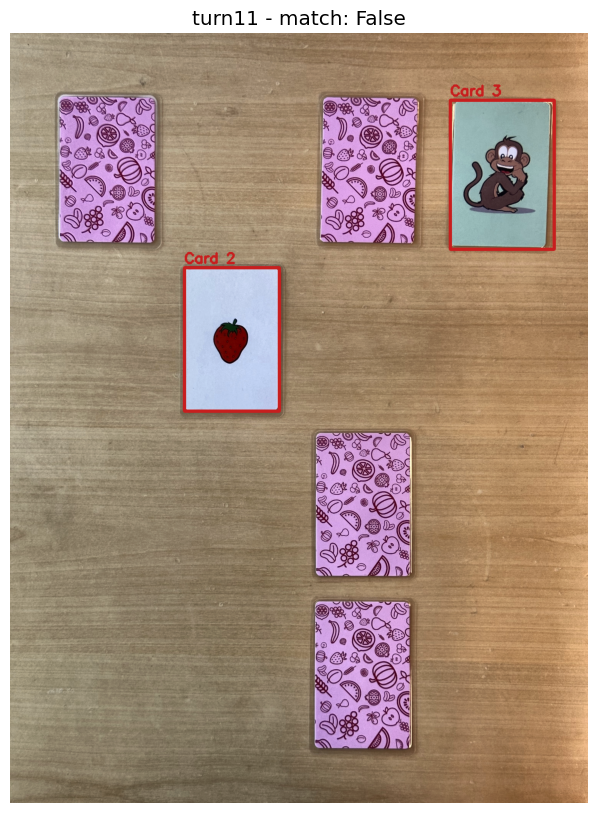

In [12]:
evaluation_config = {
    "turn7": {
        "path": img_paths['turns'][6],
        "gt_count": 12,
        "gt_faceup": [4, 10],
        "gt_match": {"card1": 4, "card2": 10, "ground_truth": True}
    },
    "turn11": {
        "path": img_paths['turns'][10],
        "gt_count": 6,
        "gt_faceup": [2, 3],
        "gt_match": {"card1": 2, "card2": 3, "ground_truth": False}
    }
}

for turn_name, config in evaluation_config.items():
    result = evaluate_turn(
        turn_name,
        config["path"],
        config["gt_count"],
        config["gt_faceup"],
        config["gt_match"],
        game
    )

    print(f"\n=== Evaluation of {turn_name} ===")
    print(f"Detection Accuracy: {result['det_acc']:.2f}%")
    print(f"Classification Accuracy: {result['cls_acc']:.2f}%")
    print(f"Matching Accuracy: {result['match_acc']:.2f}%")

    plt.imshow(cv2.cvtColor(result['image'], cv2.COLOR_BGR2RGB))
    plt.title(f"{turn_name} - match: {result['match_result']}")
    plt.axis('off')
    plt.show()
